# Inférence sur Parcours_1 avec Panoptic FPN et Faster R-CNN

[Table des matières]

# Préparatifs

In [1]:
import numpy as np
import pandas as pd
import cv2
import time
from datetime import timedelta
import json
from google.colab.patches import cv2_imshow  # remplace cv2.imshow dans le notebook

import detectron2
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

/home/centrale/redev/redev_videosurbaines/.venv/lib/python3.6/site-packages/google/colab/data_table.py:30: UserWarning: IPython.utils.traitlets has moved to a top-level traitlets package.
  from IPython.utils import traitlets as _traitlets


## Dataset

In [2]:
dataset_path = '../datasets/Parcours_1/'
freq = 1
dataset_images_path = dataset_path + 'images/'
metadata = pd.read_csv(dataset_path + f'data_{freq}hz.csv', header=None, names=['img_name', 'filename'])  # Nom des images dans le dataset
metadata.head()

,img_name,filename
0,132859305850000,132859305850000.png
1,132860306850000,132860306850000.png
2,132861307850000,132861307850000.png
3,132862308850000,132862308850000.png
4,132863309850000,132863309850000.png


## Utils

In [3]:
def get_predictor(config_url, cpu=False):
    '''Copié du notebook colab depuis https://github.com/facebookresearch/detectron2'''
    cfg = get_cfg()
    # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
    cfg.merge_from_file(model_zoo.get_config_file(config_url))
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
    # Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(config_url)
    if cpu:
        cfg.MODEL.DEVICE = "cpu"
    predictor = DefaultPredictor(cfg)
    return predictor, cfg

def draw_panoptic_predictions(im, panoptic_seg, segments_info, cfg):
    """im: BGR image.
    returns a BGR image"""
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1)
    v = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
    return v.get_image()[:, :, ::-1]

def draw_mask_predictions(im, output, cfg):
    """im: BGR image.
    returns a BGR image"""
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1)
    v = v.draw_instance_predictions(output.to("cpu"))
    return v.get_image()
        
def display_random_outputs(output_path, dataset_metadata, n=5):
    rand_idx = np.random.choice(dataset_metadata.shape[0], size=n, replace=False)
    rand_idx.sort()
    for _, row in dataset_metadata.loc[rand_idx, :].iterrows():
        print(row['img_name'])
        im = cv2.imread(output_path + 'images/' + row['filename'])[:, :, ::-1]
        cv2_imshow(im)

In [4]:
def run_inference(config_url, dataset_metadata, output_path, method):
    """method : one of 'panoptic', 'mask', 'faster'"""
    predictor, cfg = get_predictor(config_url)
    outputs = dict()  # sauvegarde des segments_info
    times = []
    lines = []  # Logs
    n_images = dataset_metadata.shape[0]
    pas_affichage = int(n_images / 10)
    global_start = time.time()
    print (f"Début de l'inférence sur {n_images} images")
    for idx, row in dataset_metadata.iterrows():
        im = cv2.imread(dataset_images_path + row['filename'])  # BGR
        # Inférence
        start = time.time()
        preds = predictor(im)
        end = time.time()
        # Sauvegarde des résultats
        if method == "panoptic":
            panoptic_seg, segments_info = preds["panoptic_seg"]
            output = segments_info
            im_output = draw_panoptic_predictions(im, panoptic_seg, segments_info, cfg)
        elif method == "mask":
            output = {'scores': list(map(float, preds["instances"].get('scores').to('cpu').numpy())),
                      'pred_classes': list(map(int, preds["instances"].get('pred_classes').to('cpu').numpy()))}
            im_output = draw_mask_predictions(im, preds["instances"], cfg)
        elif method == "faster":
            output = {'scores': list(map(float, preds["instances"].get('scores').to('cpu').numpy())),
                      'pred_classes': list(map(int, preds["instances"].get('pred_classes').to('cpu').numpy()))}
            im_output = draw_mask_predictions(im, preds["instances"], cfg)
        else:
            raise ValueError(f"Paramether 'method' can only be 'panoptic', 'mask' or 'faster'. \
                             Value given: {method}")
        times.append(end - start)
        outputs[row['img_name']] = output
        cv2.imwrite(output_path + 'images/' + row['filename'], im_output)
        # Affichage
        if (idx + 1) % pas_affichage == 0:
            line = f'{idx+1}/{n_images} images traitées en {timedelta(seconds=time.time()-global_start)}'
            print(line)
            lines.append(line)
    # Logs
    tps_inf_moy = np.mean(times)
    with open(output_path + 'logs.txt', 'w') as f:
        f.writelines(lines)
    with open(output_path + 'outputs.json', 'w') as f:
        json.dump(outputs, f)
    print(f"Fin de l'inférence. {n_images} images traitées en {timedelta(seconds=time.time()-global_start)}")
    print(f"Temps moyen par image : {tps_inf_moy:.2f}s")

# Panoptic FPN

In [6]:
output_path = f'panoptic_fpn/Parcours_1_{freq}hz/'
config_url = 'COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml'
run_inference(config_url, metadata, output_path, "panoptic")

Début de l'inférence sur 10 images
2/10 images traitées en 0:00:14.743769
3/10 images traitées en 0:00:22.848025
4/10 images traitées en 0:00:29.878758
5/10 images traitées en 0:00:37.566431
6/10 images traitées en 0:00:45.326843
7/10 images traitées en 0:00:53.298885
8/10 images traitées en 0:01:00.476309
9/10 images traitées en 0:01:07.911274
10/10 images traitées en 0:01:15.752196
Fin de l'inférence. 10 images traitées en 0:01:15.752410
Temps moyen par image : 6.47s


132916412900000


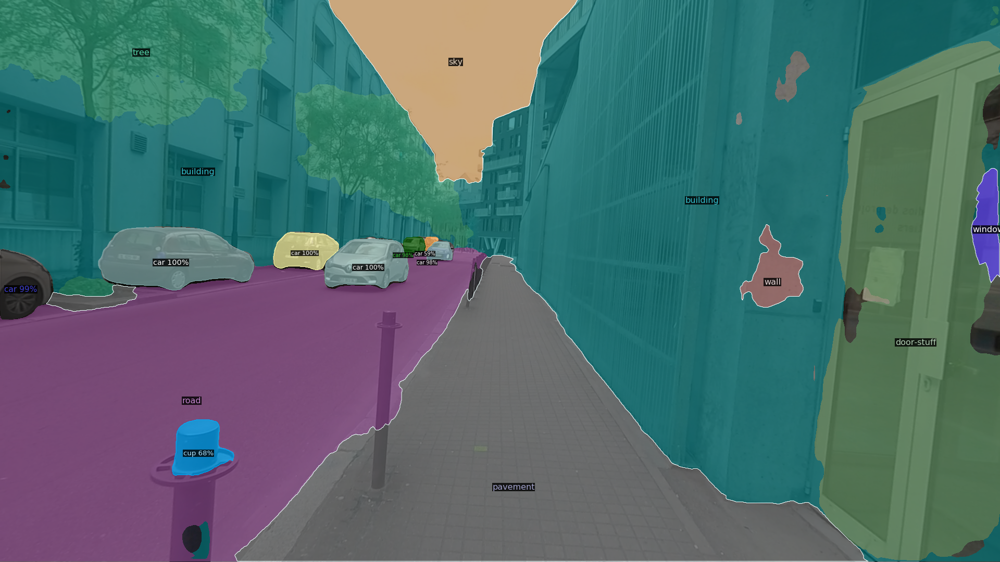

132976573000000


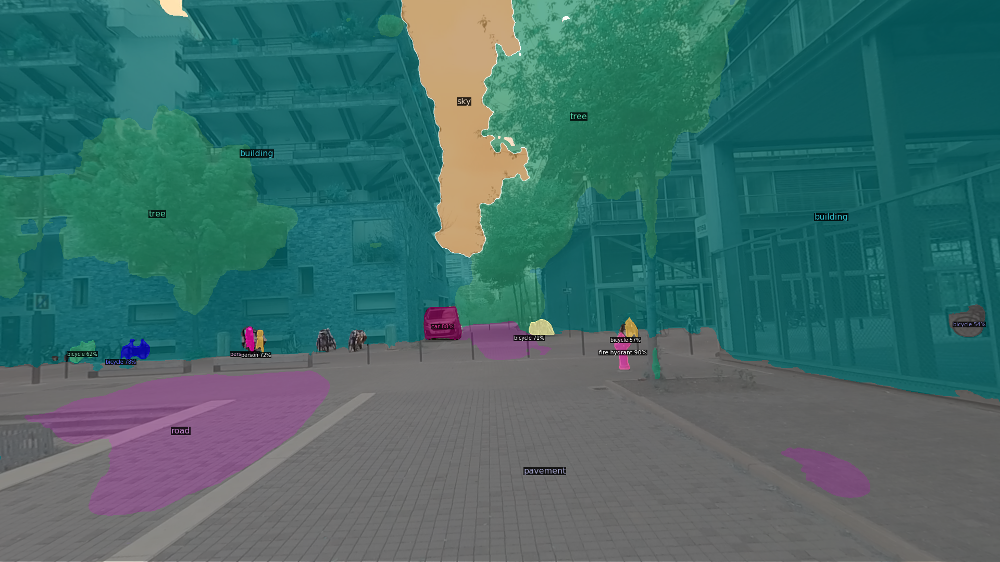

132996593000000


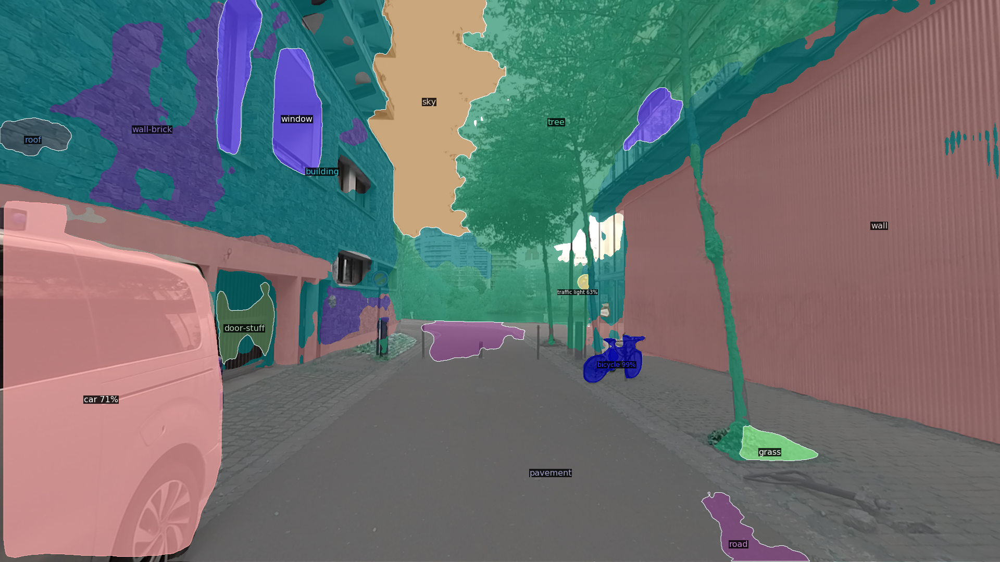

133205101300000


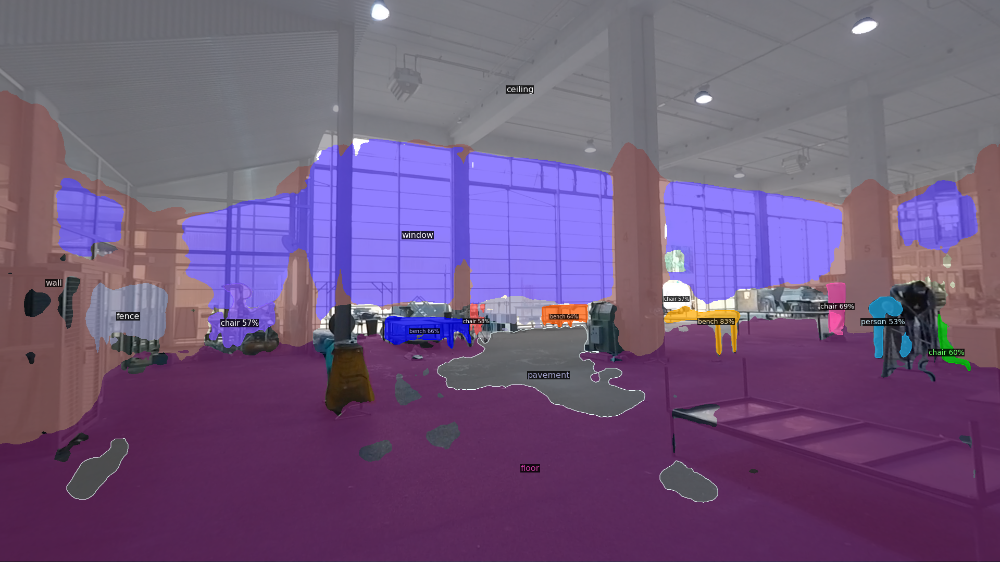

133246192350000


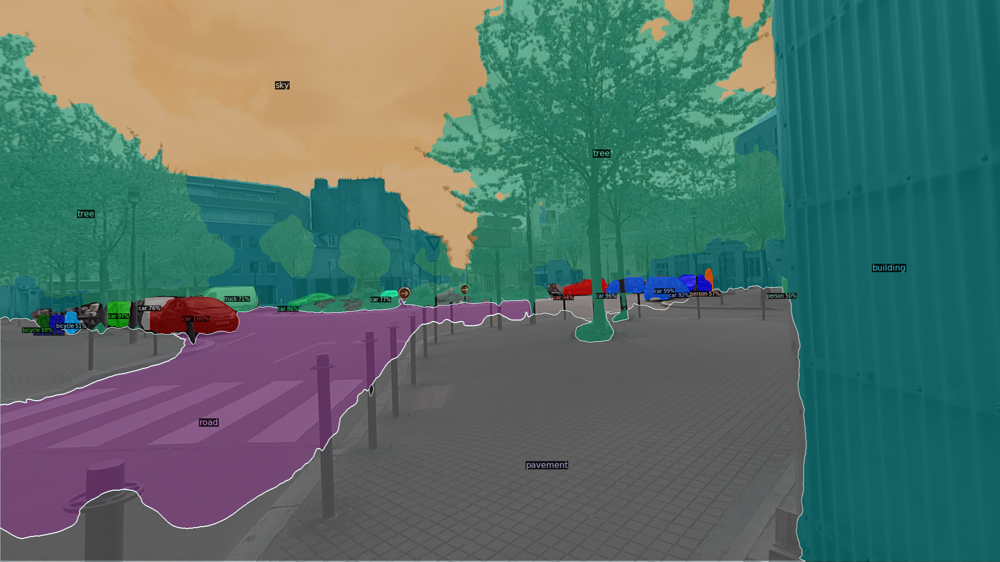

In [8]:
display_random_outputs(output_path, metadata)

# Mask R-CNN R50

In [10]:
output_path = f'mask_rcnn/Parcours_1_{freq}hz/'
config_url = 'COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml'
run_inference(config_url, metadata, output_path, "mask")

model_final_a54504.pkl: 178MB [00:16, 11.0MB/s]                               


Début de l'inférence sur 424 images
42/424 images traitées en 0:00:29.243921
84/424 images traitées en 0:00:57.171505
126/424 images traitées en 0:01:26.115852
168/424 images traitées en 0:01:52.847320
210/424 images traitées en 0:02:22.491857
252/424 images traitées en 0:02:51.566388
294/424 images traitées en 0:03:19.097252
336/424 images traitées en 0:03:45.535470
378/424 images traitées en 0:04:12.333059
420/424 images traitées en 0:04:41.901220
Fin de l'inférence. 424 images traitées en 0:04:44.543678
Temps moyen par image : 0.33s


132946492950000


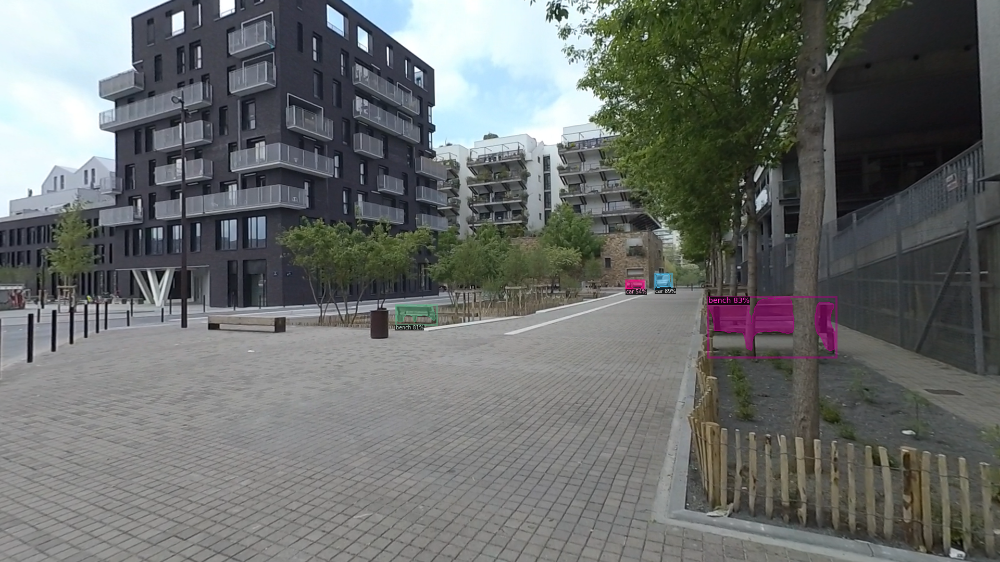

133035682050000


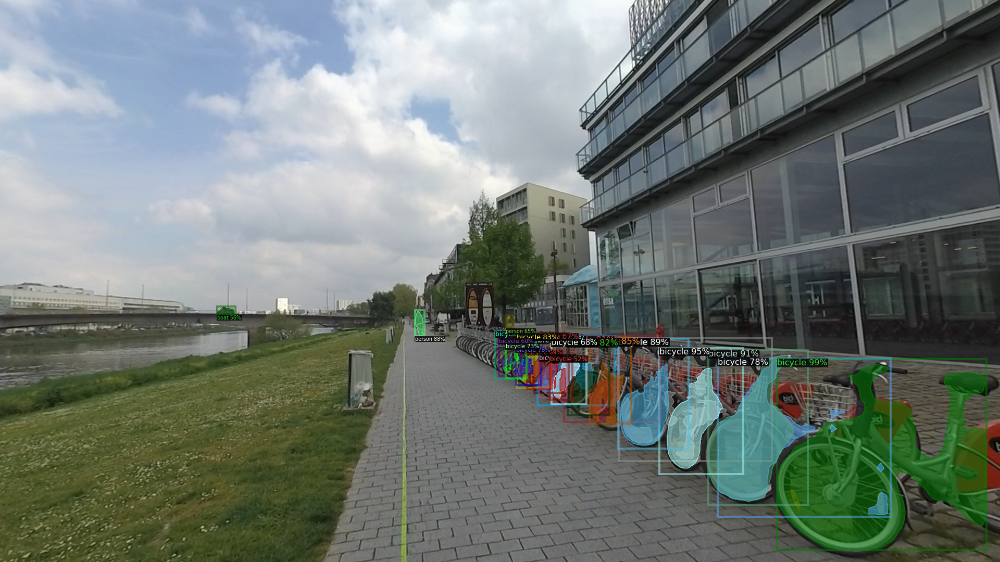

133092839150000


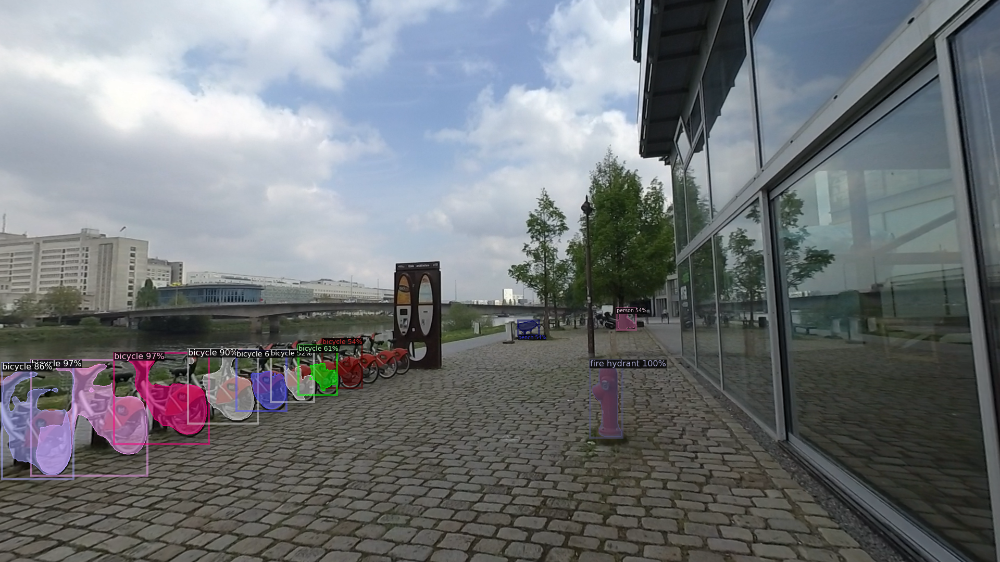

133093840150000


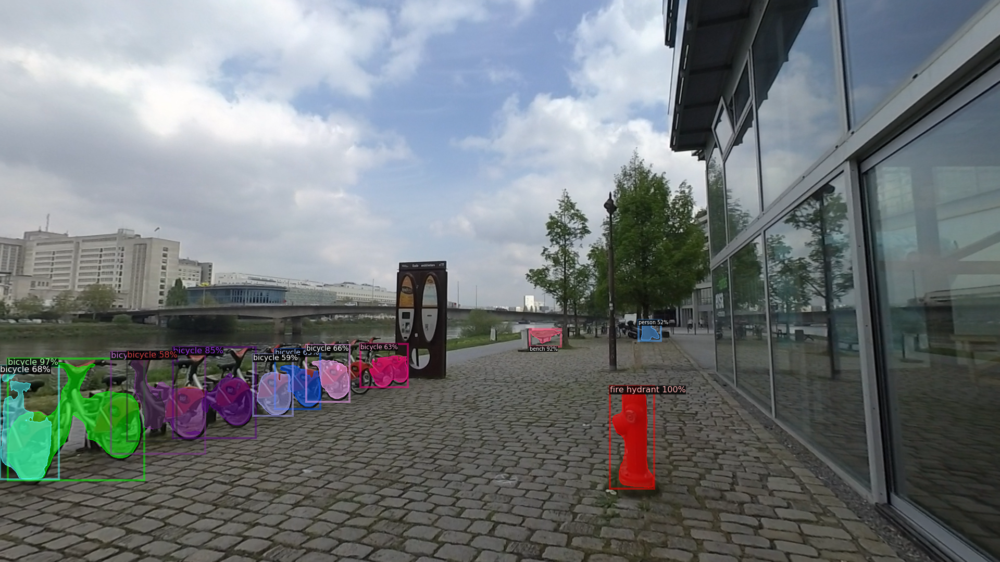

133281277400000


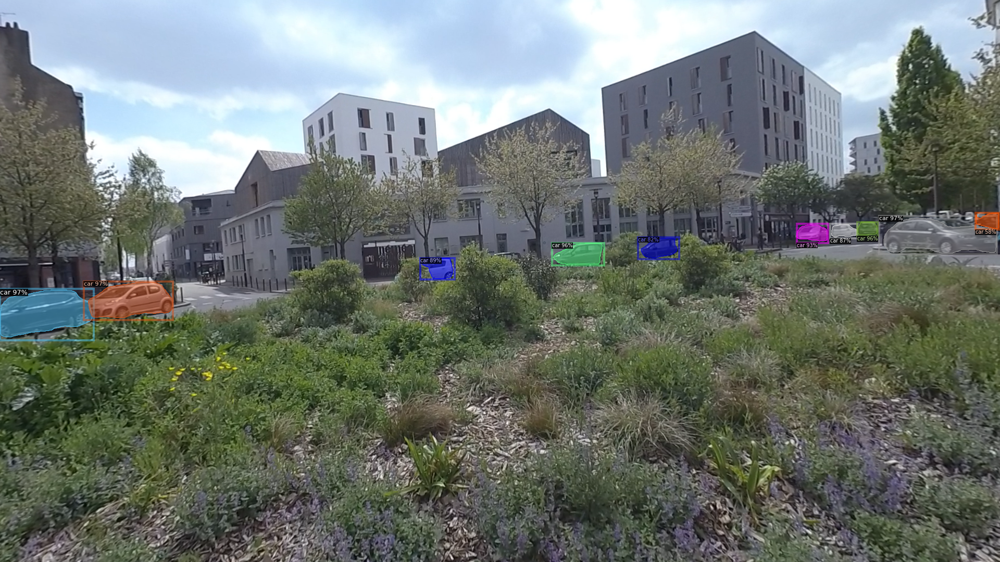

In [11]:
display_random_outputs(output_path, metadata)

# Faster R-CNN R50

In [12]:
output_path = f'faster_rcnn/Parcours_1_{freq}hz/'
config_url = 'COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml'
run_inference(config_url, metadata, output_path, "faster")

model_final_280758.pkl: 167MB [00:15, 10.8MB/s]                              


Début de l'inférence sur 424 images
42/424 images traitées en 0:00:24.835604
84/424 images traitées en 0:00:49.524817
126/424 images traitées en 0:01:14.617405
168/424 images traitées en 0:01:38.692524
210/424 images traitées en 0:02:03.858815
252/424 images traitées en 0:02:28.952614
294/424 images traitées en 0:02:53.770208
336/424 images traitées en 0:03:18.152806
378/424 images traitées en 0:03:42.738163
420/424 images traitées en 0:04:08.192386
Fin de l'inférence. 424 images traitées en 0:04:10.686632
Temps moyen par image : 0.32s


132962508950000


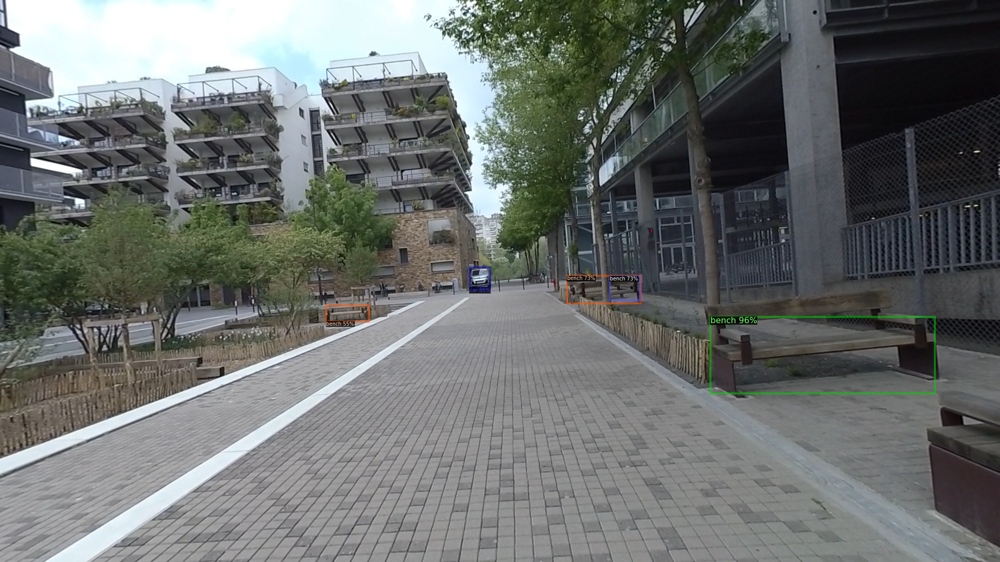

133156002250000


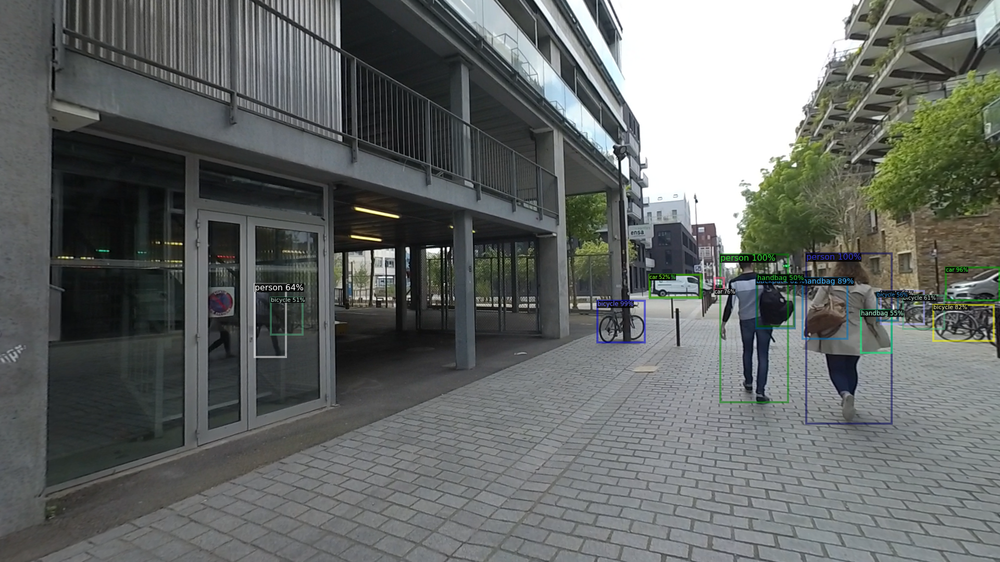

133179075300000


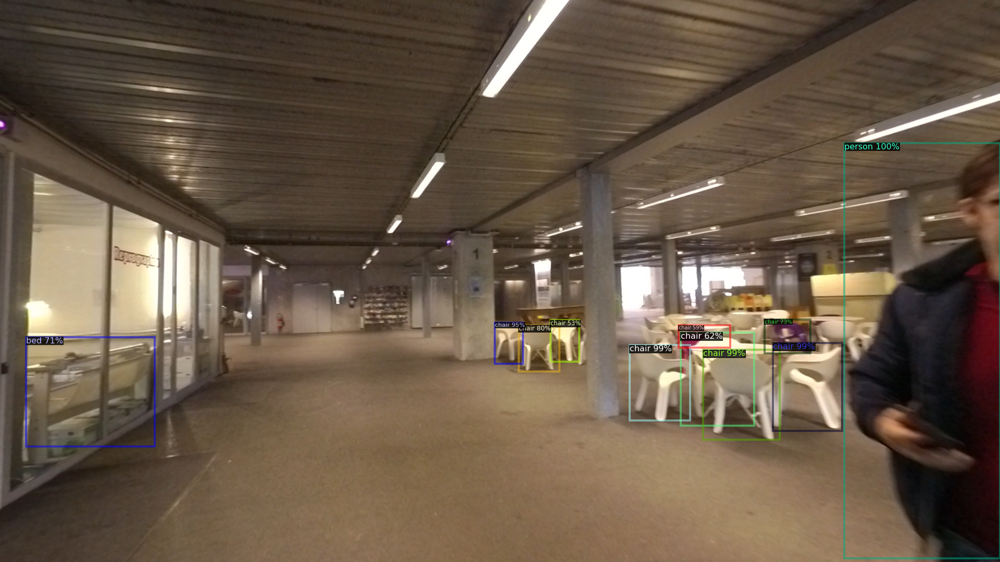

133184080300000


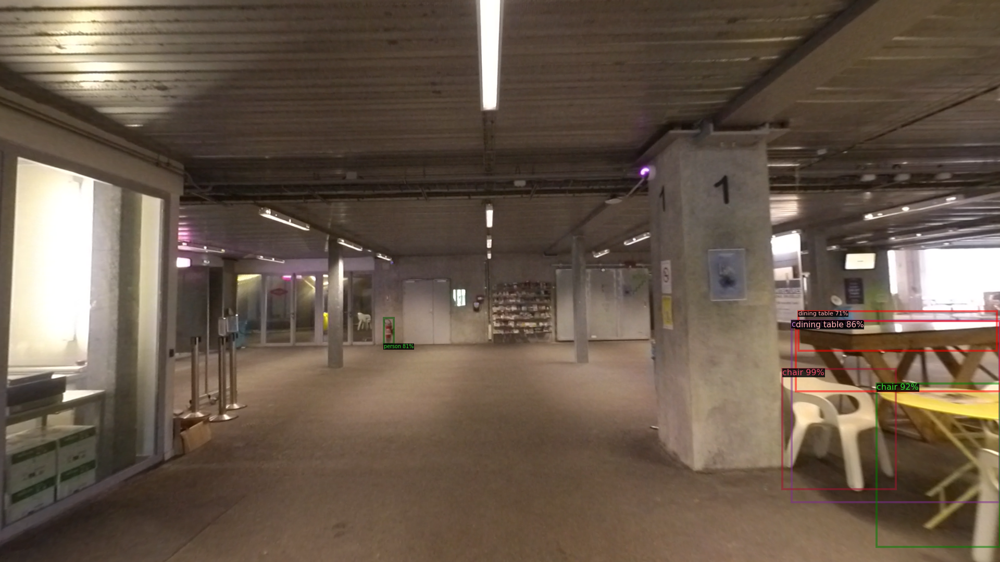

133235181350000


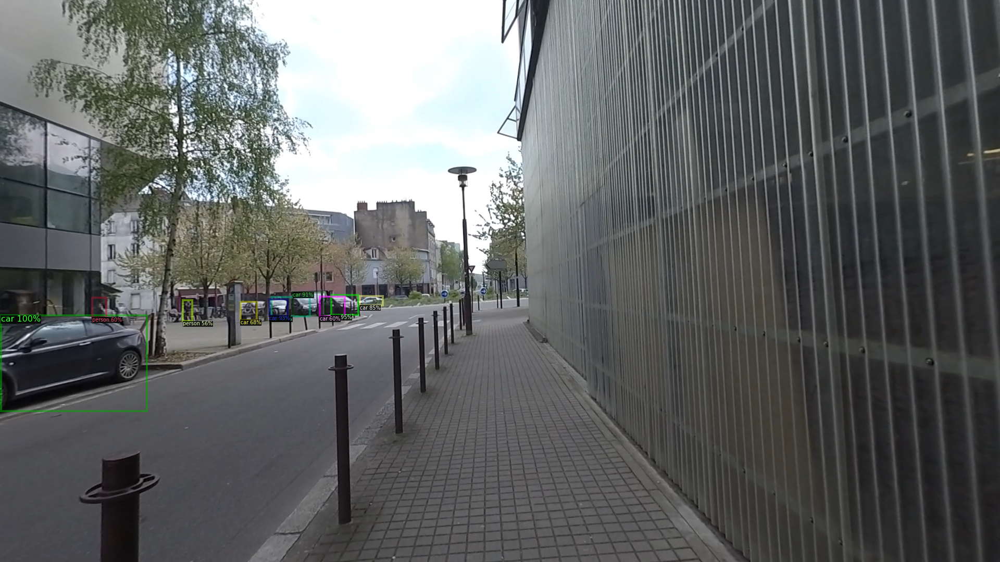

In [13]:
display_random_outputs(output_path, metadata)